# Case 3 : Exploratory Data Analysis

## Importing all necessary libraries

In [1]:
import numpy as np
import pandas as pd
import cufflinks as cf
import matplotlib.pyplot as plt
import seaborn as sns


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from datetime import datetime as dt
import calendar as cal

init_notebook_mode(connected=True)
cf.go_offline()


from IPython.core.display import HTML

%matplotlib inline

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


# Variable Description
- datetime, year-month-day hour:minute:second  
- Appliances, energy use in Wh  
- lights, energy use of light fixtures in the house in Wh  
- T1, Temperature in kitchen area, in Celsius  
- RH_1, Humidity in kitchen area, in %  
- T2, Temperature in living room area, in Celsius  
- RH_2, Humidity in living room area, in %  
- T3, Temperature in laundry room area  
- RH_3, Humidity in laundry room area, in %  
- T4, Temperature in office room, in Celsius  
- RH_4, Humidity in office room, in %  
- T5, Temperature in bathroom, in Celsius  
- RH_5, Humidity in bathroom, in %  
- T6, Temperature outside the building (north side), in Celsius  
- RH_6, Humidity outside the building (north side), in %  
- T7, Temperature in ironing room , in Celsius  
- RH_7, Humidity in ironing room, in %  
- T8, Temperature in teenager room 2, in Celsius  
- RH_8, Humidity in teenager room 2, in %  
- T9, Temperature in parents room, in Celsius  
- RH_9, Humidity in parents room, in %  
- To, Temperature outside (from Chièvres weather station), in Celsius  
- Pressure (from Chièvres weather station), in mm Hg  
- RH_out, Humidity outside (from Chièvres weather station), in %  
- Windspeed (from Chièvres weather station), in m/s  
- Visibility (from Chièvres weather station), in km  
- Tdewpoint (from Chièvres weather station), °C  
- rv1, Random variable 1, nondimensional  
- rv2, Rnadom variable 2, nondimensional  

In [2]:
df = pd.read_csv('https://s3.us-east-2.amazonaws.com/ads-demo1/E_Dataset.csv',parse_dates=['date'])

## Counting the number of null values in each column

In [3]:
#Total Count of Nulls in the data
nulls_df = pd.DataFrame(df.isnull().sum(),columns=['Count of Nulls'])
nulls_df

,Count of Nulls
date,0
Appliances,0
lights,0
T1,0
RH_1,0
T2,0
RH_2,0
T3,0
RH_3,0
T4,0


We can see from the above results that the data does not have any nulls in any of the columns, hence we can proceed with our analysis.

In [4]:
print(df.shape)

(19735, 29)


## Datatypes of all the columns

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
date           19735 non-null datetime64[ns]
Appliances     19735 non-null int64
lights         19735 non-null int64
T1             19735 non-null float64
RH_1           19735 non-null float64
T2             19735 non-null float64
RH_2           19735 non-null float64
T3             19735 non-null float64
RH_3           19735 non-null float64
T4             19735 non-null float64
RH_4           19735 non-null float64
T5             19735 non-null float64
RH_5           19735 non-null float64
T6             19735 non-null float64
RH_6           19735 non-null float64
T7             19735 non-null float64
RH_7           19735 non-null float64
T8             19735 non-null float64
RH_8           19735 non-null float64
T9             19735 non-null float64
RH_9           19735 non-null float64
T_out          19735 non-null float64
Press_mm_hg    19735 non-null float64
RH_out        

The datatype of all the columns are as required and we do not need to modify them.

## Summary Statistics

In [6]:
#Using HTML display so that all the columns of the dataframe are visible
display(HTML(df.describe().to_html()))

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,19.592106,50.949283,7.910939,54.609083,20.267106,35.388200,22.029107,42.936165,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,1.844623,9.022034,6.090347,31.149806,2.109993,5.114208,1.956162,5.224361,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,15.330000,29.815000,-6.065000,1.000000,15.390000,23.200000,16.306667,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,18.277500,45.400000,3.626667,30.025000,18.700000,31.500000,20.790000,39.066667,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,19.390000,49.090000,7.300000,55.290000,20.033333,34.863333,22.100000,42.375000,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,20.619643,53.663333,11.256000,83.226667,21.600000,39.000000,23.390000,46.536000,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,25.795000,96.321667,28.290000,99.900000,26.000000,51.400000,27.230000,58.780000,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


## Observations :

- Almost 75% of the data in the lights column is 0, it is unclear whether the value is intentionally 0 or unknown
- Looking at the 50% percentile and the mean we assume there are no outliers for the features provided except for the variable "Appliances"

In [7]:
df[(df['lights'] == 0) & (df['date'].dt.day == 12) & (df['date'].dt.month == 1) & (df['date'].dt.year == 2016)]

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
51,2016-01-12 01:30:00,50,0,20.926667,45.590000,20.290000,44.290000,20.166667,45.530000,21.890000,...,16.890000,46.290000,5.150000,737.900000,92.000000,5.500000,40.000000,3.950000,43.060474,43.060474
52,2016-01-12 01:40:00,40,0,20.890000,45.666667,20.230000,44.290000,20.133333,45.500000,21.823333,...,16.890000,46.433333,5.166667,738.033333,92.000000,5.333333,40.000000,3.966667,21.904855,21.904855
53,2016-01-12 01:50:00,50,0,20.890000,46.060000,20.200000,44.400000,20.200000,45.500000,21.666667,...,16.890000,46.633333,5.183333,738.166667,92.000000,5.166667,40.000000,3.983333,12.239864,12.239864
54,2016-01-12 02:00:00,40,0,20.790000,46.200000,20.200000,44.466667,20.166667,45.500000,21.533333,...,16.890000,46.826667,5.200000,738.300000,92.000000,5.000000,40.000000,4.000000,3.533952,3.533952
55,2016-01-12 02:10:00,50,0,20.790000,46.200000,20.100000,44.530000,20.125000,45.425000,21.356667,...,16.963333,46.966667,5.133333,738.400000,92.000000,4.833333,40.000000,3.933333,4.973308,4.973308
56,2016-01-12 02:20:00,50,0,20.700000,46.260000,20.100000,44.590000,20.133333,45.400000,21.230000,...,17.000000,47.230000,5.066667,738.500000,92.000000,4.666667,40.000000,3.866667,15.813585,15.813585
57,2016-01-12 02:30:00,50,0,20.700000,46.200000,20.000000,44.433333,20.200000,45.500000,21.066667,...,17.000000,47.363333,5.000000,738.600000,92.000000,4.500000,40.000000,3.800000,25.931713,25.931713
58,2016-01-12 02:40:00,40,0,20.600000,46.200000,20.000000,44.500000,20.200000,45.500000,20.926667,...,17.000000,47.530000,4.933333,738.700000,92.000000,4.333333,40.000000,3.733333,33.100254,33.100254
59,2016-01-12 02:50:00,40,0,20.600000,46.126667,20.000000,44.500000,20.200000,45.400000,20.745000,...,17.000000,47.663333,4.866667,738.800000,92.000000,4.166667,40.000000,3.666667,20.341509,20.341509
60,2016-01-12 03:00:00,30,0,20.566667,46.066667,19.890000,44.590000,20.200000,45.400000,20.666667,...,17.000000,47.826667,4.800000,738.900000,92.000000,4.000000,40.000000,3.600000,45.643796,45.643796


The above information states that even though there were no lights used for a particular day 01/12/2016, appliances still utilized some energy

## Histograms for all numeric quantities

In [8]:
cols = list(df.columns)

for col in cols :
    if col not in ['date','rv1','rv2']:
        df[col].iplot(kind='hist',xTitle=col,yTitle='Counts')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


### Since rv1 and rv2 are dummy variables, we are not including them in the histograms
### Observations
1) 4365 number of time (highest), appliances contributed an energy level of 50  
2) 15252 times the lights were off, the reason is unknown   
3) Variables RH1, T2 and RH5 are skewed towards left while RH2, Press_mm_hg and RH_out are skewed on right

## Pairplot for 1st Subset of Data

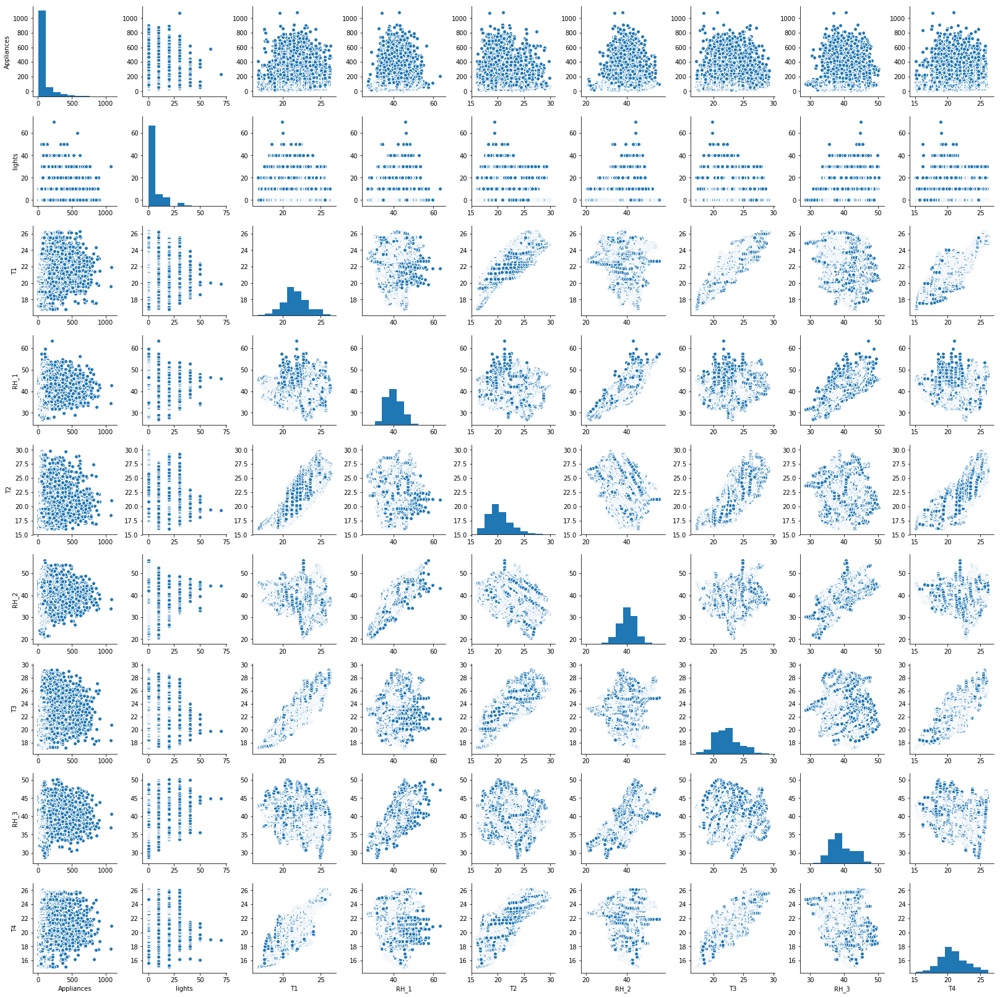

In [9]:
sns.pairplot(df.loc[:,'date':'T4'])

## Pairplot for 2nd Subset of Data

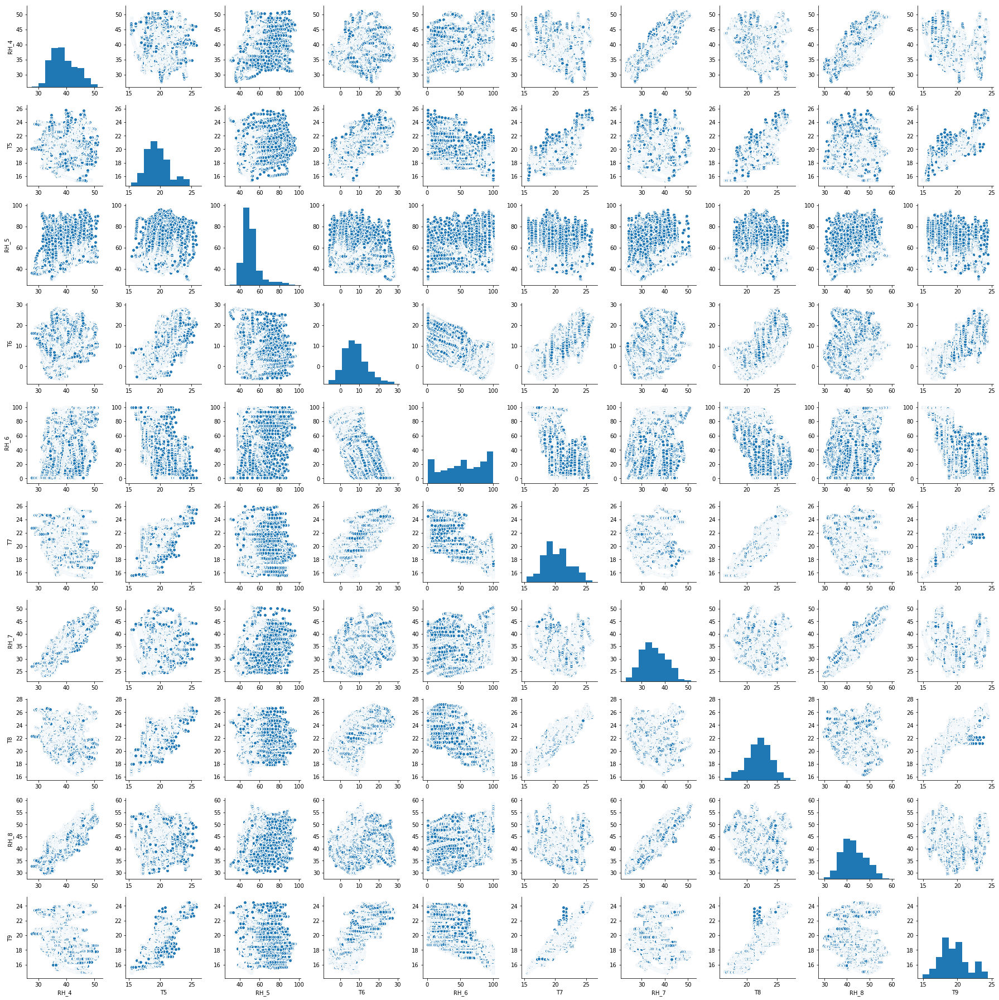

In [12]:
sns.pairplot(df.loc[:,'RH_4':'T9'])

## Pairplot for 3rd Subset of Data

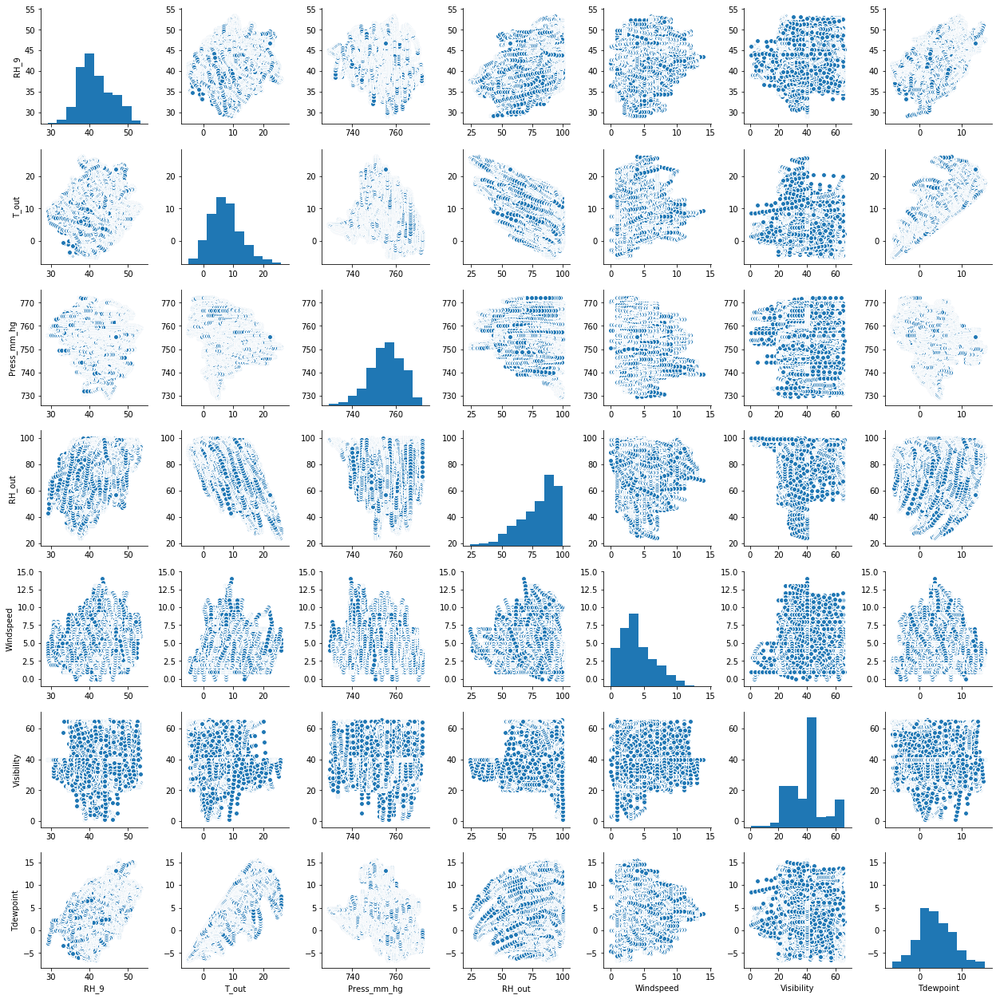

In [13]:
sns.pairplot(df.loc[:,'RH_9':'Tdewpoint'])

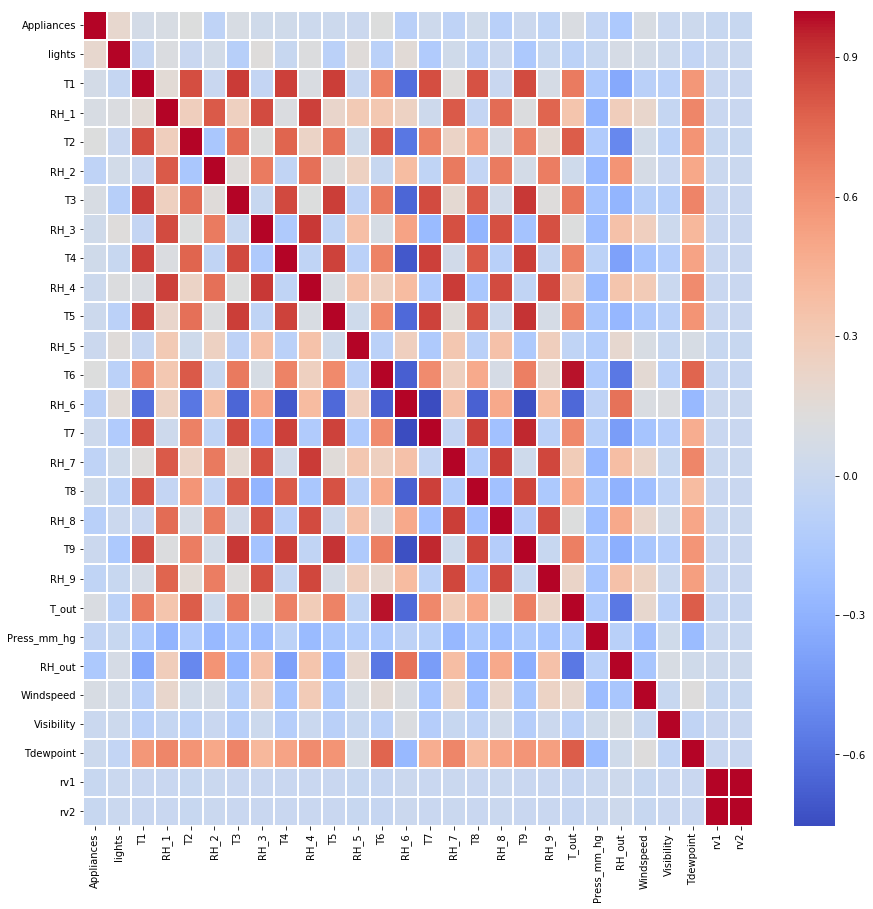

In [14]:
plt.figure(figsize=(15,15))
sns.heatmap(df.corr(),linewidths=1,cmap='coolwarm')

## Time Series Analysis of Appliance Energy Consumption

In [15]:
df['year'] = df['date'].dt.year
df['quarter'] = df['date'].dt.quarter
df['month'] = df['date'].dt.month
df['weekNumberInYear'] = df['date'].dt.week
df['dayOfMonth'] = df['date'].dt.day
df['dayInWeek'] = df['date'].dt.dayofweek.apply(lambda x : cal.day_name[x])
df['hourOfDay'] = df['date'].dt.hour
df['minute'] = df['date'].dt.minute

In [16]:
df.groupby('month').sum()['Appliances'].iplot(
    yTitle='Consumption in Watt-Hour',
    xTitle='Month Number',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [17]:
df.groupby('weekNumberInYear').sum()['Appliances'].iplot(
    xTitle='Week Number in Year',
    yTitle='Consumption in Watt-Hour',
    title='Week Number Wise Consumption in Watt-Hour',
    colors='Red',
    mode='lines+markers')

 The highest consumption was on 14th week followed by 11th week and the least consumption was on 21st week the last week of May

In [18]:
df.groupby('dayOfMonth').sum()['Appliances'].iplot(
    xTitle='Day of the Month',
    yTitle='Consumption in Watt-Hour',
    title='Day Wise Consumption in Watt-Hour',
    colors='Red',
    mode='lines+markers')

Energy was consumed the highest on 14th, 15th and 16th day across all the month

In [19]:
df.groupby('dayInWeek').sum()['Appliances'].iplot(
    xTitle='Day In Week',
    yTitle='Consumption in Watt-Hour',
    title='Weekly Consumption in Watt-Hour',
    colors='Red',
    mode='lines+markers')

It is very clear that on Mondays appliances consumed the highest energy folllowed by Fridays 

In [20]:
df.groupby('hourOfDay').sum()['Appliances'].iplot(
    xTitle='Hour of the Day',
    yTitle='Consumption in Watt-Hour',
    title='Hour Wise Consumption in Watt-Hour',
    colors='Red',
    mode='lines+markers')

Highest consumtion of energy is observed from 5pm to 7pm throughout